# Hotel Booking Analysis

## Project Summary

Hotel Booking EDA is an exploratory data analysis project that analyzes hotel booking data. The dataset used in the project contains information on bookings made by guests such as booking dates, lead times, number of adults/children, room types, and cancellation status. The main objective of this EDA is to gain insights into the booking patterns and trends of guests and to identify factors that contribute to booking cancellations. The analysis includes data cleaning, data visualization, and statistical analysis using Python libraries such as pandas, numpy, matplotlib, and seaborn. The findings of this EDA can be useful for hotel managers and marketers to optimize their pricing strategies, room allocation, and cancellation policies.

# Importing Library

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Loading the dataset

In [2]:
df=pd.read_csv("Hotel Bookings.csv")

# Exploring the dataset

In [3]:
df.head(5)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

## Data Description:


1. hotel : Hotel(Resort Hotel or City Hotel)

2. is_canceled : Value indicating if the booking was canceled (1) or not (0)

3. lead_time :* Number of days that elapsed between the entering date of the booking into the PMS and the arrival date*

4. arrival_date_year : Year of arrival date

5. arrival_date_month : Month of arrival date

6. arrival_date_week_number : Week number of year for arrival date

7. arrival_date_day_of_month : Day of arrival date

8. stays_in_weekend_nights : Number of weekend nights (Saturday or Sunday) the guest stayed or booked to stay at the hotel

9. stays_in_week_nights : Number of week nights (Monday to Friday) the guest stayed or booked to stay at the hotel

10. adults : Number of adults

11. babies : Number of babies

12. meal : Type of meal booked. Categories are presented in standard hospitality meal packages:

13. country : Country of origin.

14. market_segment : Market segment designation. In categories, the term “TA” means “Travel Agents” and “TO” means “Tour Operators”

15. distribution_channel : Booking distribution channel. The term “TA” means “Travel Agents” and “TO” means “Tour Operators”

16. is_repeated_guest : Value indicating if the booking name was from a repeated guest (1) or not (0)

17. previous_bookings_not_canceled : Number of previous bookings not cancelled by the customer prior to the current booking

18. reserved_room_type : Code of room type reserved. Code is presented instead of designation for anonymity reasons.

19. assigned_room_type : Code for the type of room assigned to the booking.

20. booking_changes : Number of changes/amendments made to the booking from the moment the booking was entered on the PMS until the moment of check-in or cancellation

21. deposit_type : Indication on if the customer made a deposit to guarantee the booking.

22. agent : ID of the travel agency that made the booking

23. company : ID of the company/entity that made the booking or responsible for paying the booking.

24. days_in_waiting_list : Number of days the booking was in the waiting list before it was confirmed to the customer

25. customer_type : Type of booking, assuming one of four categories

26. adr : Average Daily Rate as defined by dividing the sum of all lodging transactions by the total number of staying nights

27. required_car_parking_spaces : Number of car parking spaces required by the customer

28. total_of_special_requests :* Number of special requests made by the customer (e.g. twin bed or high floor)*

29. reservation_status : Reservation last status, assuming one of three categories
                   . Canceled – booking was canceled by the customer
                   . Check-Out – customer has checked in but already departed
30.  No-Show – customer did not check-in and did inform the hotel of the reason why

31. reservation_status_date : Date at which the last status was set. This variable can be used in conjunction with the 

32. ReservationStatus to understand when was the booking canceled or when did the customer checked-out of the hotel

In [5]:
df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,103050.000000,6797.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,2016.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,86.693382,189.266735,2.321149,101.831122,0.062518,0.571363
std,0.482918,106.863097,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,110.774548,131.655015,17.594721,50.535790,0.245291,0.792798
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,62.000000,0.000000,69.290000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,179.000000,0.000000,94.575000,0.000000,0.000000
75%,1.000000,160.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,229.000000,270.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


## Data Cleaning 

In [6]:
df.duplicated().value_counts()

False    87396
True     31994
dtype: int64

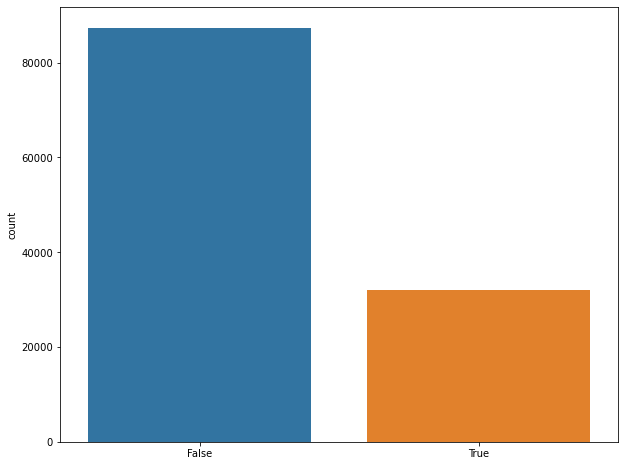

In [7]:
# Visulizing through Count pot
plt.figure(figsize=(10,8))
sns.countplot(x=df.duplicated());

In [8]:
# now lets drop the missing values 

df=df.drop_duplicates()

In [9]:
df.shape

(87396, 32)

In [10]:
# Now handling the missing values 

df.isnull().sum()

hotel                                 0
is_canceled                           0
lead_time                             0
arrival_date_year                     0
arrival_date_month                    0
arrival_date_week_number              0
arrival_date_day_of_month             0
stays_in_weekend_nights               0
stays_in_week_nights                  0
adults                                0
children                              4
babies                                0
meal                                  0
country                             452
market_segment                        0
distribution_channel                  0
is_repeated_guest                     0
previous_cancellations                0
previous_bookings_not_canceled        0
reserved_room_type                    0
assigned_room_type                    0
booking_changes                       0
deposit_type                          0
agent                             12193
company                           82137


### As we saw there are null values in columns(agent, children,company,country). we are replacing missing values.

Text(0.5, 1.0, 'Places of missing values in column')

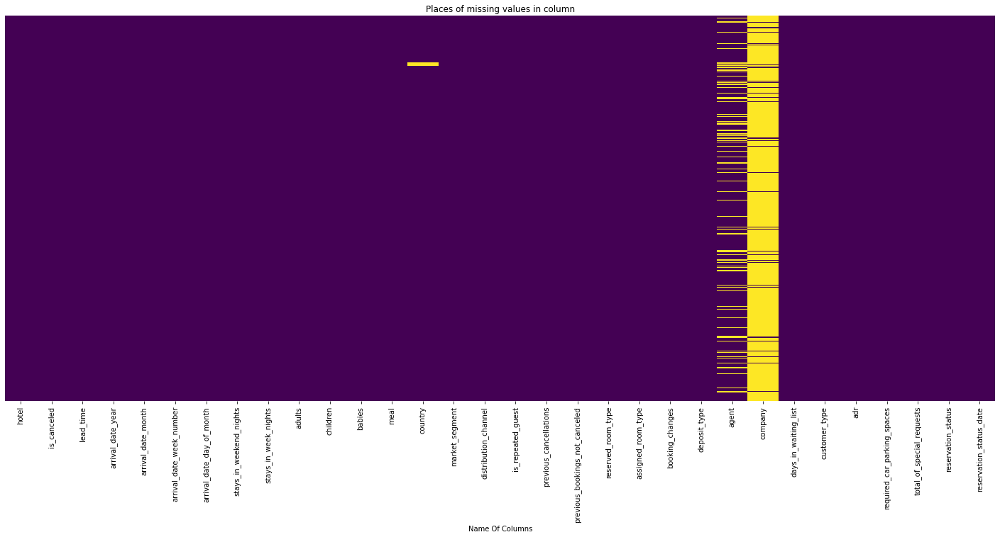

In [11]:
# Visulaizing null values through heatmap.
plt.figure(figsize=(25, 10))
sns.heatmap(df.isnull(), cbar=False, yticklabels=False,cmap='viridis')
plt.xlabel("Name Of Columns")
plt.title("Places of missing values in column")

In [12]:
# Filling/replacing null values with 0.
null_columns=['agent','children','company']
for col in null_columns:
  df[col].fillna(0,inplace=True)

Since, company and agent columns have comany number and agent numbers as data. There may be some cases when customer didnt booked hotel via any agent or via any company. So in that case values can be null under these columns.
We will replace null values by 0 in these columns

In [13]:
# Replacing NA values with 'others'
df['country'].fillna('others',inplace=True)

In [14]:
df.isna().sum()

hotel                             0
is_canceled                       0
lead_time                         0
arrival_date_year                 0
arrival_date_month                0
arrival_date_week_number          0
arrival_date_day_of_month         0
stays_in_weekend_nights           0
stays_in_week_nights              0
adults                            0
children                          0
babies                            0
meal                              0
country                           0
market_segment                    0
distribution_channel              0
is_repeated_guest                 0
previous_cancellations            0
previous_bookings_not_canceled    0
reserved_room_type                0
assigned_room_type                0
booking_changes                   0
deposit_type                      0
agent                             0
company                           0
days_in_waiting_list              0
customer_type                     0
adr                         

In [15]:
# droppping all 166 those rows in which addtion of of adlults ,children and babies is 0. That simply means  no bookings were made.
len(df[df['adults']+df['babies']+df['children']==0])
df.drop(df[df['adults']+df['babies']+df['children']==0].index,inplace=True)

We found 166 rows in the dataset where the total number of adults, children, and babies was zero. - This means that no hotel bookings were made for those guest. To deal with this, we chose to remove these rows from the dataset.

In [16]:
df.shape

(87230, 32)

In [17]:
# Converting datatype of columns 'children', 'company' and 'agent' from float to int.
df[['children', 'company', 'agent']] = df[['children', 'company', 'agent']].astype('int64')

In [18]:
# changing datatype of column 'reservation_status_date' to data_type.
df['reservation_status_date'] = pd.to_datetime(df['reservation_status_date'], format = '%Y-%m-%d')

In [19]:
# Adding total staying days in hotels
df['total_stay'] = df['stays_in_weekend_nights']+df['stays_in_week_nights']

In [20]:
# Adding total people num as column, i.e. total people num = num of adults + children + babies
df['total_people'] = df['adults']+df['children']+df['babies']

# EDA

### There are two types of hotels in the data 'City' and 'Resort'.

In [21]:
Hotel_typ =df['hotel'].value_counts()
Hotel_typ

City Hotel      53274
Resort Hotel    33956
Name: hotel, dtype: int64

Text(0.5, 1.0, 'Hotel type')

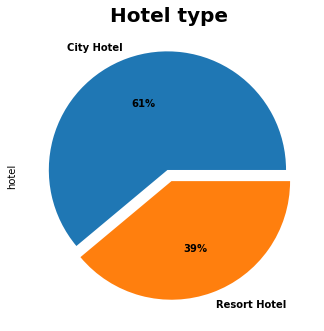

In [22]:
plt.subplot(2,2,1 )
Hotel_typ.plot.pie(x='City Hotel', y ='Resort Hotel',autopct='%1.0f%%',textprops={'weight': 'bold'},figsize =(12,12),explode =[0.05]*2) 
plt.title('Hotel type',fontweight="bold", size=20)

From the above plot we see that City Hotel is most preffered hotel by guests. Thus city hotels has maximum bookings

## prefrerred meal type by the guest

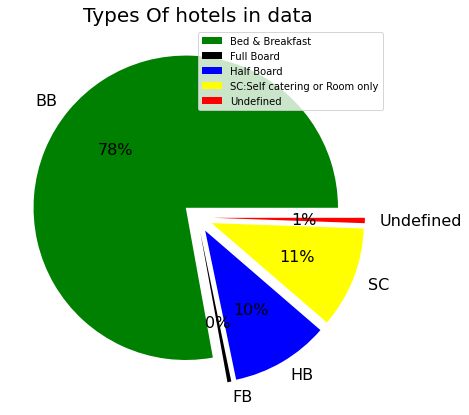

In [23]:
meal_data = df.groupby('meal')['hotel'].count()

# create a pie chart
plt.figure(figsize=(10, 7))

meal_data.plot(kind='pie',colors=['green', 'black', 'blue', 'yellow', 'red'], autopct='%1.0f%%', fontsize=16,explode = (0.1, 0.1,0.1,0.1,0.1))

plt.legend(labels=['Bed & Breakfast', 'Full Board','Half Board','SC:Self catering or Room only','Undefined'], loc="best")

plt.title('Types Of hotels in data', fontsize=20)

plt.ylabel('')
plt.xlabel('')
plt.show();

### BB --bed and breakfast. HB--half board (in which breakfast and dinner are included.) FB--full board (in which breakfast, lunch and dinner are included.)

AS we can see 78% of people prefer 'BB' type meal

## Customer types 

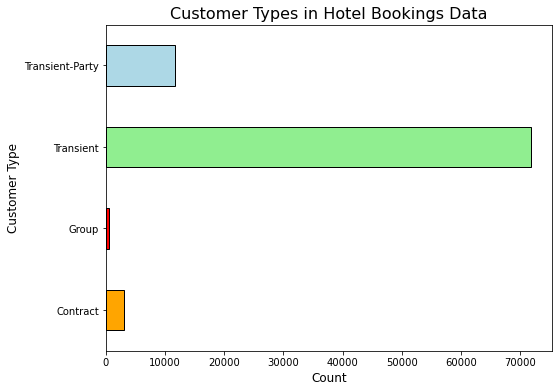

In [24]:
customer_data = df.groupby('customer_type')['hotel'].count()

# create a horizontal bar chart
plt.figure(figsize=(8, 6))

customer_data.plot(kind='barh', color=['orange', 'red', 'lightgreen', 'lightblue'], edgecolor='black')

plt.title('Customer Types in Hotel Bookings Data', fontsize=16)
plt.xlabel('Count', fontsize=12)
plt.ylabel('Customer Type', fontsize=12)

plt.show();

There are 4 types of Customer. Out of them most are 'Transient Type"

## About Parking space

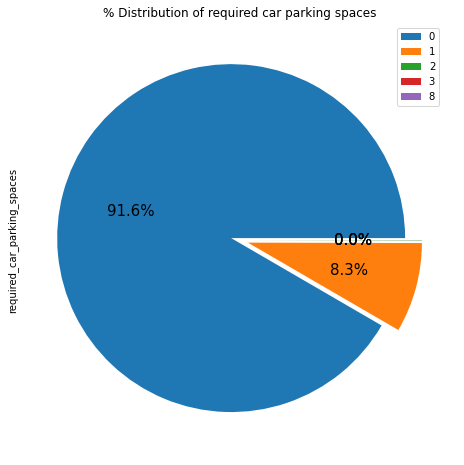

In [25]:
df['required_car_parking_spaces'].value_counts().plot.pie(explode=[0.05]*5, autopct='%1.1f%%',shadow=False,figsize=(10,8),fontsize=15,labels=None)

labels=df['required_car_parking_spaces'].value_counts().index
plt.title('% Distribution of required car parking spaces')
plt.legend(bbox_to_anchor=(0.85, 1), loc='upper left', labels=labels);

only 8% people require parking spaces

## Deposite type for hotel Bookings

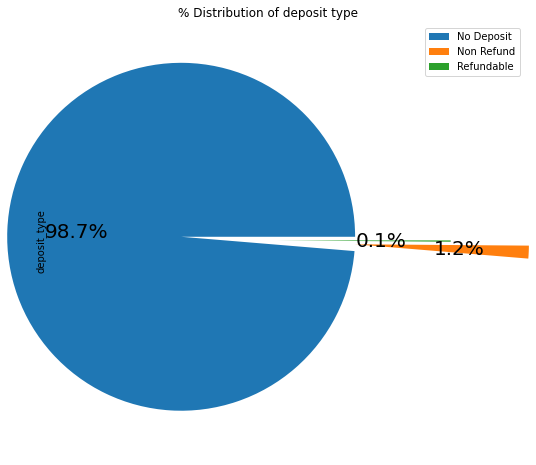

In [26]:
df['deposit_type'].value_counts().plot.pie(explode=(0.5,0.5,0.05),autopct='%1.1f%%',shadow=False,figsize=(14,8),fontsize=20,labels=None)
plt.title("% Distribution of deposit type")
labels=df['deposit_type'].value_counts().index.tolist()
plt.legend(bbox_to_anchor=(0.85, 1), loc='upper left', labels=labels);

98.7 % of the guests prefer "No deposit" type of deposit.

## Hotel Wise Bookings based on Date Month and year

In [27]:
# groupby arrival_date_month and taking the hotel count
bookings_by_months_df=df.groupby(['arrival_date_month'])['hotel'].count().reset_index().rename(columns={'hotel':"Counts"})
# Create list of months in order
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
# creating df which will map the order of above months list without changing its values.
bookings_by_months_df['arrival_date_month']=pd.Categorical(bookings_by_months_df['arrival_date_month'],categories=months,ordered=True)
# sorting by arrival_date_month
bookings_by_months_df=bookings_by_months_df.sort_values('arrival_date_month')

In [28]:
bookings_by_months_df.value_counts()


arrival_date_month  Counts
January             4685      1
February            6083      1
March               7489      1
April               7900      1
May                 8344      1
June                7756      1
July                10043     1
August              11242     1
September           6682      1
October             6921      1
November            4973      1
December            5112      1
dtype: int64

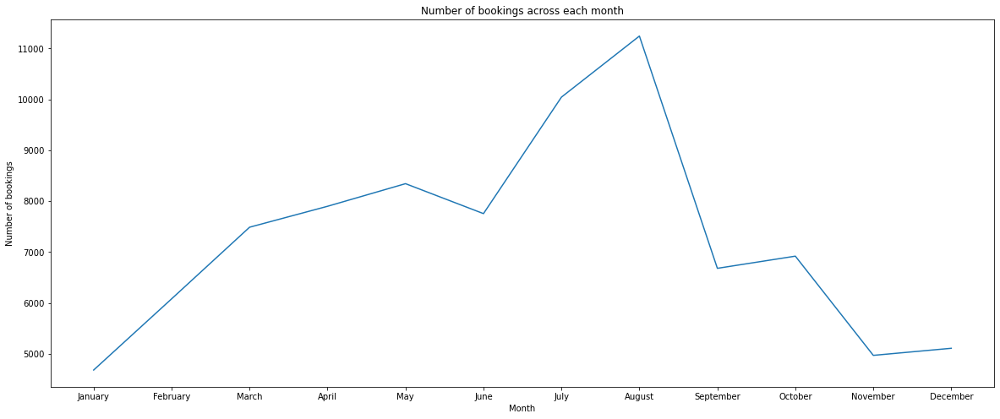

In [29]:
plt.figure(figsize=(20,8))

sns.lineplot(x=bookings_by_months_df['arrival_date_month'],y=bookings_by_months_df['Counts'])
plt.title('Number of bookings across each month')
plt.xlabel('Month')
plt.ylabel('Number of bookings');

July and August months had the most Bookings. Summer vaccation can be the reason for the bookings.

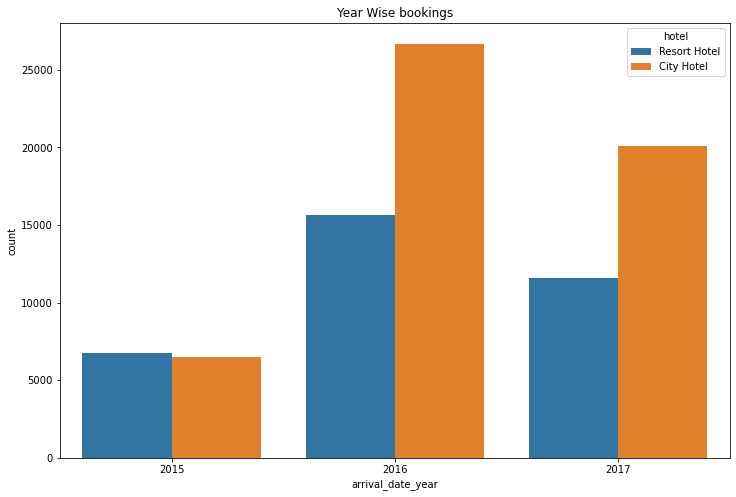

In [30]:

plt.figure(figsize=(12,8))

#  plot with countplot
sns.countplot(x=df['arrival_date_year'],hue=df['hotel'])
plt.title("Year Wise bookings");

2016 had the higest bookings.
2015 had less 7000 bookings.
overall City hotels had the most of the bookings.

## From Where the most guests are coming ?????

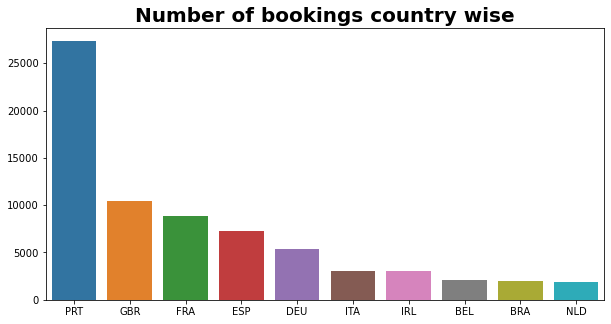

In [31]:
plt.figure(figsize = (10,5))

sns.barplot (y= list(df.country.value_counts().head (10)), x= list(df.country.value_counts().head(10).index))
plt.title("Number of bookings country wise",fontweight="bold", size=20);

Most of the guests are coming from portugal i.e more 25000 guests are from portugal
abbreevations for countries-

PRT- Portugal
GBR- United Kingdom
FRA- France
ESP- Spain
DEU - Germany
ITA -Itlay
IRL - Ireland
BEL -Belgium
BRA -Brazil
NLD-Netherlands

## Which is the most preferred room type by the customers?

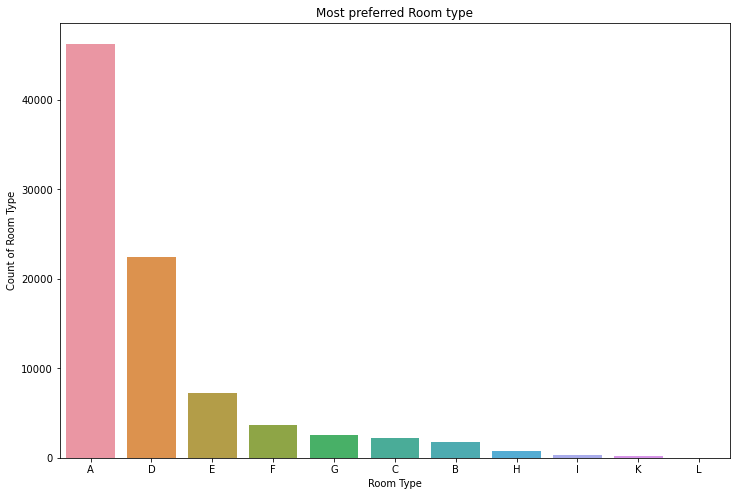

In [32]:
plt.figure(figsize=(12,8))

#plotting 
sns.countplot(x=df['assigned_room_type'],order=df['assigned_room_type'].value_counts().index)
#  set xlabel for the plot
plt.xlabel('Room Type')
# set y label for the plot
plt.ylabel('Count of Room Type')
#set title for the plot
plt.title("Most preferred Room type");

So the most preferred Room type is "A".

## Which Distribution channel is mostly used for hotel bookings?

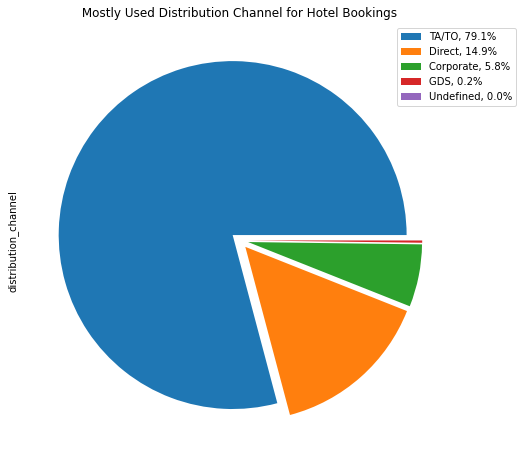

In [33]:

labels=df['distribution_channel'].value_counts().index.tolist()


distribution_channel_df=df['distribution_channel'].value_counts().reset_index().rename(columns={'index':"distribution_channel",'distribution_channel':'count'})

distribution_channel_df['percentage']=round(distribution_channel_df['count']*100/df.shape[0],1)


sizes=distribution_channel_df['percentage'].values.tolist()

df['distribution_channel'].value_counts().plot.pie(explode=[0.05, 0.05,0.05,0.05,0.05], shadow=False, figsize=(15,8),fontsize=10,labels=None)   


labels = [f'{l}, {s}%' for l, s in zip(labels, sizes)]
plt.legend(bbox_to_anchor=(0.85, 1), loc='upper left', labels=labels)
plt.title(' Mostly Used Distribution Channel for Hotel Bookings ');

TA/TO' is mostly(79.1%) used for booking hoetls.

## Cancellation rates

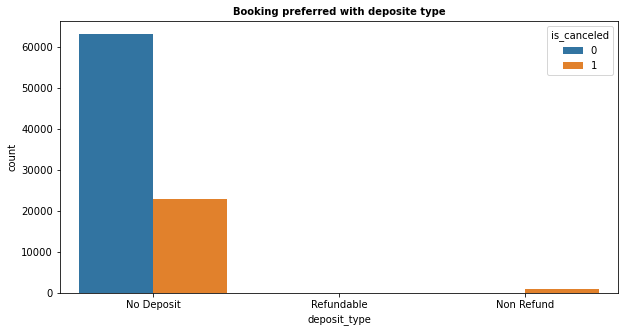

In [34]:
plt.figure(figsize = (10,5))
sns.countplot(x='deposit_type',data=df,hue ='is_canceled')
plt.title('Booking preferred with deposite type',fontweight ="bold",size =10);

As expected , Most Bookings are done with 'No deposite' and most cancellations are also in 'no deposit' bookings. It is a surprise to see cancellations with 'Non-refundable' bookings

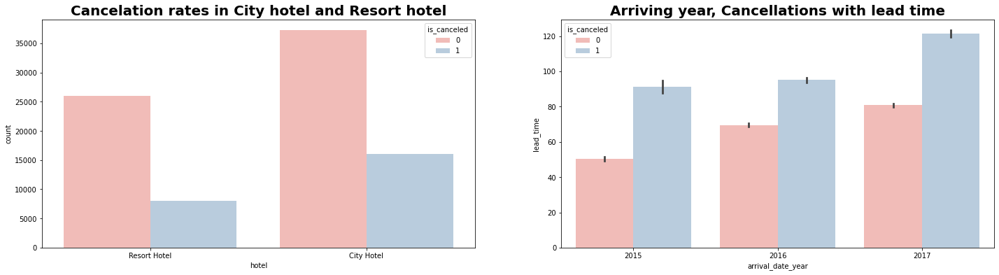

In [35]:
plt.figure(figsize=(12, 6))
plt.subplot(1,2,1 )
sns.countplot(x='hotel',hue="is_canceled", data=df,palette='Pastel1')
plt.title("Cancelation rates in City hotel and Resort hotel",fontweight="bold", size=20)
plt.subplot(1,2,2 )
sns.barplot(x='arrival_date_year', y='lead_time',hue='is_canceled', data= df, palette='Pastel1')
plt.title('Arriving year, Cancellations with lead time',fontweight="bold", size=20)
plt.subplots_adjust(right=1.7);

Cancelation rate is higher in city hotel. With more lead time there is more possibility of booking cancellation.

## Waiting time

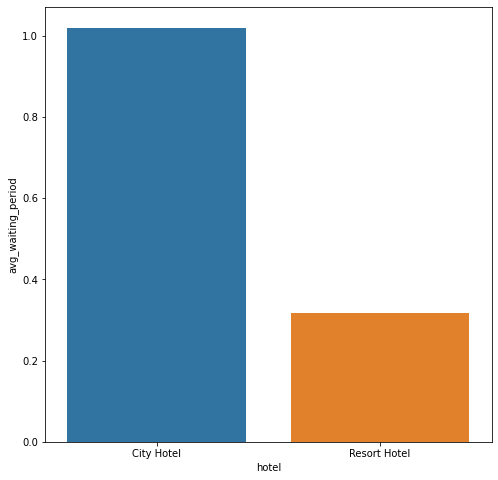

In [36]:
grouped_by_hotel = df.groupby('hotel') #creating a DF which store groupby 'Hotel' rows
Waiting_df = pd.DataFrame(grouped_by_hotel['days_in_waiting_list'].agg(np.mean).reset_index().rename(columns = {'days_in_waiting_list':'avg_waiting_period'}))
plt.figure(figsize = (8,8))
sns.barplot(x = Waiting_df['hotel'], y = Waiting_df['avg_waiting_period'] )
plt.show();

City hotel has significantly longer waiting time, hence City Hotel is much busier than Resort Hotel.

## Which Hotels has the most repeated guests?

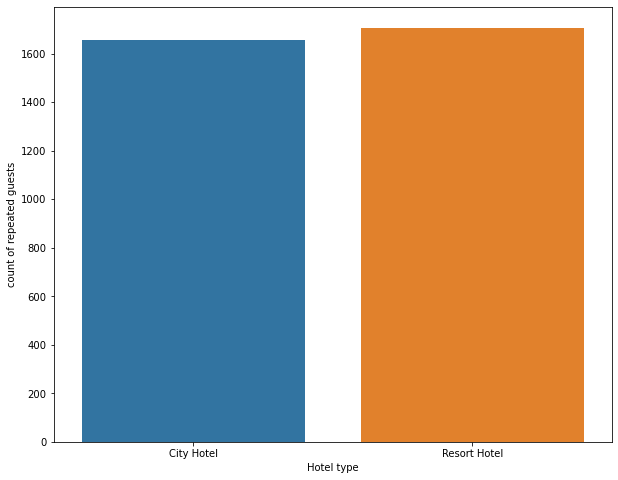

In [37]:
#groupby hotel
repeated_guests_df=df[df['is_repeated_guest']==1].groupby('hotel').size().reset_index().rename(columns={0:'number_of_repated_guests'})



#set plot size adn plot barplot
plt.figure(figsize=(10,8))
sns.barplot(x=repeated_guests_df['hotel'],y=repeated_guests_df['number_of_repated_guests'])

# set labels
plt.xlabel('Hotel type')
plt.ylabel('count of repeated guests');

Resort Hotel has slightly more repeated guests than the City Hotels. It is almost similar for both hotels.

In [38]:
from pandas_profiling import ProfileReport 

In [39]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Conclusion

 ## what are the infromations gains from the data ?

- Looking at the charts, we can see that Resort hotels have a longer average length of stay compared to City hotels. This could be due to the fact that Resort hotels are often located in vacation destinations where people go for longer periods of time, while City hotels are more frequently used for business trips or shorter stays. In this most guests in the dataset (61%) preferred city hotels, whereas fewer guests (39%) preferred resort hotels, means city hotels are more in demand. This informations can be use to make strategic decisions about how to market, price, allocate resources, and invest in hotels. For example, businesses could promote city hotels more, adjust their pricing, and focus more on improving amenities and services in their city hotels. By doing so, businesses can better satisfy their guests' preferences and increase their revenue.
It's important for hotels to understand these differences and market their properties and attract the right types of guests,like for example resorts could offer longer-stay packages or activities to cso that guests will extended vacation, while city hotels could focus on providing better services for guests who are often on the go.The guests who are looking for longer stays resort shuld add some extra amenities such as spa, golf course, or beach activities.

- chart highlights that most of the hotel guests were adults, which can help the hotel make decisions about their services and marketing strategies. This includes catering towards adults by offering adult-oriented activities and improving business-oriented services. The chart is an effective way to visualize the information with a clear representation of the proportion of each age group.


- The graph shows that guests booking city hotels had longer wait times for confirming their bookings compared to resort hotels. It indicates that guests booking city hotels generally had to wait longer than those booking resort hotels. Hotels can improve their booking processes and reduce wait times to enhance customer satisfaction and increase revenue

- From the graph information can help hotels and travel companies better understand their customers' preferences make decisions regarding advertising, marketing, inventory management, and pricing.They can focus on most popular meal package options, adding new items in it,and giving best pricing so that hotels can improve customer satisfaction and increase revenue.

- The chart shows that the majority of bookings are made by Transient and Transient-Party customers, while Contract and Group customers make fewer bookings. This suggests that hotels may want to focus their marketing efforts on attracting and retaining Transient and Transient-Party customers, as they represent the largest segment of their customer base.

- The chart reveals that most hotel bookings do not require a deposit, with non-refundable deposits being more common than refundable deposits. This means that many customers prefer not to pay a deposit in advance, although some customers are happy to pay a non-refundable deposit. The chart can help hotels to understand what their customers prefer and adapt their booking policies accordingly. For example, hotels may choose to offer more flexible deposit options or promote non-refundable deposits to customers who prefer them.

- The chart shows seasonal trends and patterns in hotel bookings throughout the year. The number of bookings increases from January to May, peaks in July and August, but drops in September and October. Bookings in November and December are significantly lower. By understanding these trends, hotels can develop strategies to attract more customers during periods of low demand and maximize revenue during periods of high demand. For example, giving some extra features during off-season reconstructing prizes
for example Hotels can increase there prices and more marketing efforts during periods of high demand, such as July and August.hotels can offer discounts and promotions during periods of low demand, such as September and October, to attract more customers.

- The insight found from the chart is that the number of hotel bookings decreased in the years following 2016. This information is important for hotels and travel companies to understand booking trends and adjust their marketing strategies to attract more customers. They may need to identify the reasons behind this decline, such as changes in the market or industry, and respond accordingly to remain competitive. It is also essential for them to monitor booking trends over time and adjust their strategies accordingly to remain successful in the industry.

- The chart shows that a majority of the bookings do not have a parking space, suggesting that parking spaces may not be a top priority for hotel guests or hotels may not be fulfilling the demand. However, there is still a significant number of bookings with parking spaces, suggesting that hotels may need to offer this amenity to attract certain types of guests.
For example, if a hotel is located in an area with limited parking options, offering parking spaces may attract more customers and increase revenue

- Looking at the graph, we can see that Resort hotels have a longer average length of stay compared to City hotels. This could be due to the fact that Resort hotels are often located in vacation destinations where people go for longer periods of time, while City hotels are more frequently used for business trips or shorter stays.
It's important for hotels to understand these differences and market their properties and attract the right types of guests,like for example resorts could offer longer-stay packages or activities to cso that guests will extended vacation, while city hotels could focus on providing better services for guests who are often on the go.

The guests who are looking for longer stays resort shuld add some extra amenities such as spa, golf course, or beach activities.

- From the  chart, we can see that there are seasonal patterns in cancellations. The months of January, February, and December have the highest number of cancellations, while the months June, July, and August have the lowest number of cancellations.
from graph we can see that there are some factors that are affecting ancellations during different times of the year. like in winter month the cancellations are high may be beacuse weather condition or holiday plans while in summer we see fewer cancellations due to more travel plans, vacation time

Understanding the patterns in cancellations can help hotels plan their staffing and inventory levels better , considering the up's and down's in cancellations manage their resources and provide better customer service which will leads to customer satisfaction so that they can make more profit.

- When they see the chart, hotels can learn new things about people who stay at their hotel. They can use that information to make better choices about how to make money. For example, if they see that more people like to stay at their resort hotel, they can make the price higher. If they see that people like to come to their city hotel for business, they can make advertisements that tell people about the good things that are close to their hotel.
The chart can help hotels know what people like and how to make more money. It is very important for hotels to learn what people like so that they can do things that make their guests happy.

- The insight from the histogram can help hotel managers in many ways. If most guests do not have special requests, the hotel can spend resources on things that are more important to the guests, like making the rooms clean or adding more amenities. But, if a few guests do have special requests, the hotel should be prepared to take care of them quickly and efficiently. This can help ensure guest satisfaction and lead to positive reviews and repeat business.

## Overall Conclusion

After analyzing the hotel booking dataset, we found some important information. The data included two types of hotels - city hotels and resort hotels - with most guests choosing city hotels. Adults made up the majority of guests, with very few babies and children.

Resort hotels tended to have longer waiting periods for bookings compared to city hotels, and most guests did not select meal packages. Leisure bookings were more common than business travel bookings.

Additionally, many bookings were made without a deposit, and certain months had more bookings than others. Most guests did not require a parking space.

The average length of stay varied by hotel type, with resort hotels having longer stays. Cancellations were common, especially for city hotels. We also saw differences in booking patterns between leisure and business travelers.

Finally, certain room types were more popular than others, and there were variations in special requests across different booking types and customer segments.

Overall, these findings can help hotels and travel companies improve their marketing strategies and tailor their services to better meet guest needs. For example, hotels can adjust pricing strategies during peak months, improve room offerings based on guest preferences, and offer more incentives to attract business travelers.

# Solution to Business Objective

Based on the insights gained from the EDA on hotel booking data, the following recommendations can be made to the client to achieve their business objectives: • To attract more guests and make more money, consider offering special deals and promotions during times when there aren't many people booking hotels.

• Adjust pricing strategies based on seasonal trends to remain competitive in the industry.

• Provide more parking spaces or prioritize parking as an amenity to attract certain types of guests.

• Provide a wider variety of meal options that can accommodate the various dietary requirements and personal tastes of guests.

• Create marketing plans that are tailored to specific types of hotel bookings, such as those made by people traveling for work or those traveling for pleasure.

• Offer flexible deposit options to accommodate different payment preferences of guests.

• Look at the booking patterns by month and year to understand when demand is high and low. This will help in predicting future demand and making necessary adjustments in hotel operations.

• Keep track of cancellation trends and develop plans to reduce cancellations, such as providing more flexible cancellation policies or offering incentives for guests to rebook their stay.

• Create different types of rooms that are designed to meet the unique needs and preferences of different groups of customers.

• Examine the variety of special requests made by guests and focus on fulfilling the most frequent requests to enhance guest satisfaction and loyalty.

• Determine the most profitable months for hotels and adjust pricing strategies accordingly.

• Identify the most common booking channels and focus marketing efforts on those channels to increase bookings.

• Analyze the customer review data to identify areas of improvement and enhance the guest experience.

• Use data on customer demographics and booking patterns to create targeted promotions and loyalty programs to retain customers and drive repeat business.